<center>
    <img src="logo.png" height="300" width="500"/>
    <div style='font-size: 35px;'>
        <h1 style='color:#142b5a; font-weight: bold; font-family: Calibri;'>  Profit Predictions  </h1>
    </div>
</center>

 <p style='color:#142b5a; font-weight: bold; font-family: Calibri; font-size:25px;'>🎯 ** Objectives **</p>
 <br>
<div style='color:#142b5a; font-weight: light; font-family: Calibri;'>In this Notebook we will predict the profit with diffrent methods.</div>

<p style='color:#142b5a; font-weight: bold; font-family: Calibri; font-size:25px;'>✔️ ** Outline **</p> 
<br>
<a href="#import" style='color:#142b5a; font-weight: light; font-family: Calibri;'> • Importing necessary libraries</a>
<br>
<br>
<a href="#clean" style='color:#142b5a; font-weight: light; font-family: Calibri;'>• Importing the dataset</a>
<br>
<br>
<a href="#discover" style='color:#142b5a; font-weight: light; font-family: Calibri;'> • Exploring the dataset</a>
<br>
<br>
<a href="#features" style='color:#142b5a; font-weight: light; font-family: Calibri;'> • Definition of features and target</a>
<br>
<br>
<div>
    <div>
        <a href="#dn" style='color:#142b5a; font-weight: light; font-family: Calibri;'>• Data Analysis</a>
        <br>
        <a href="#cm" style='color:#142b5a; font-weight: light; font-family: Calibri; padding:0 0 0 20px'>- Correlation Map</a>
        <br>
        <a href="#visualization" style='color:#142b5a; font-weight: light; font-family: Calibri; padding:0 0 0 20px'>- Visualization of the different correlations</a>
        <br>
        <a href="#fs" style='color:#142b5a; font-weight: light; font-family: Calibri; padding:0 0 0 20px'>- Feature Selection</a>
        <br>
        <a href="#outliers" style='color:#142b5a; font-weight: light; font-family: Calibri; padding:0 0 0 20px'>- Dealing with outliers</a>
        <br>
    </div>
</div>
<br>
<div>
    <a href="#lr" style='color:#142b5a; font-weight: light; font-family: Calibri;'> • Linear Regression </a>
    <br>
    <div>
       <a href="#simple" style='color:#142b5a; font-weight: light; font-family: Calibri; padding:0 0 0 20px'> a- Simple Linear regression </a>
    <br> 
        <a href="#multiple" style='color:#142b5a; font-weight: light; font-family: Calibri; padding:0 0 0 20px'> b- Multiple Linear regression </a>
    <br> 
    </div>
    <br>
    <a href="#pr" style='color:#142b5a; font-weight: light; font-family: Calibri;'> • Polynomial Regression</a></div>
    <br>
</div>
<a href="#xgboost" style='color:#142b5a; font-weight: light; font-family: Calibri;'>• XGBOOST Method</a>
<br>
<br>
<a href="#randomForest" style='color:#142b5a; font-weight: light; font-family: Calibri;'>• RandomForest Method</a>
<br>
<br>
<a href="#comparison" style='color:#142b5a; font-weight: light; font-family: Calibri;'>• Comparison</a>
<br>
<br>

<div style='font-size:100%;'>
    <a id='import'></a>
    <h1 style='color: black; font-weight: bold; font-family: Calibri;'>
        <center> Importing necessary libraries 📚 </center>
    </h1>
 
</div>

In [3]:
import chart_studio.plotly.plotly as py
import plotly.offline as pyoff
import plotly.graph_objs as go


#import Keras
import keras
from keras.layers import Dense
from keras.models import Sequential
from keras.optimizers import Adam 
from keras.callbacks import EarlyStopping
from keras.utils import np_utils
from keras.layers import LSTM
from sklearn.model_selection import KFold, cross_val_score, train_test_split

In [4]:
import pandas as pd
import numpy as np
# Libraries for data visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from tqdm.notebook import tqdm
import pygrametl
from pygrametl.tables import Dimension
from pygrametl.tables import FactTable

<div style='font-size:100%;'>
    <a id='clean'></a>
    <h1 style='color: black; font-weight: bold; font-family: Calibri;'>
        <center> Importing the dataset ⬇️ </center>
    </h1>
</div>

In [3]:
import pyodbc 
conn2 = pyodbc.connect('Driver={SQL Server};'
                      'Server=KARIM-LEO;'
                      'Database=DW_projet;'
                      'Trusted_Connection=yes;')

cursor2 = pygrametl.ConnectionWrapper(connection=conn2)

In [4]:
# Suppress all warnings
import warnings
warnings.filterwarnings("ignore")

In [5]:
# %matplotlib command configures the library you are going to use to draw the plot le graphique
# inline indicates that we will use the library built into the notebook
%matplotlib inline

pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 100)
pd.set_option('display.float_format', lambda x: '%.2f' % x)

<div style='font-size:100%;'>
    <a id='discover'></a>
    <h1 style='color: black; font-weight: bold; font-family: Calibri;'>
        <center> Exploring the dataset 🧐 </center>
    </h1>
</div>

In [6]:
#Reading SQL query into a DataFrame 

SQL_Query = pd.read_sql_query('''select * FROM DW_Projet.dbo.FactSales''', conn2)
dataFact = pd.DataFrame(SQL_Query)
SQL_Query = pd.read_sql_query('''select DateKey,Date FROM DW_Projet.dbo.DimDate''', conn2)
dimDate = pd.DataFrame(SQL_Query)

In [7]:
dataFact

,FK_Customer,FK_Product,FK_Ship,FK_Date_Order,FK_Date_Ship,FK_Order,FK_Localisation,Quantity,Profit,Sales,Discount,Returned,Ship_Coast,Ship_Duration
0,17416,5806,5,20120703,20120706,35224,5965,7,-4.21,44.93,0.45,NO,6.91,3
1,17416,5841,8,20150107,20150111,36271,4078,5,-10.44,23.76,0.45,NO,2.84,4
2,17416,6612,5,20120703,20120706,35224,5965,2,-23.53,51.71,0.45,NO,1.77,3
3,17416,6644,5,20120703,20120706,35224,5965,13,-141.96,278.85,0.45,NO,30.01,3
4,17416,6939,5,20120703,20120706,35224,5965,1,-8.53,29.24,0.45,NO,6.66,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51246,34828,5714,7,20120919,20120921,37536,4348,4,11.94,59.94,0.10,NO,2.31,2
51247,34829,4431,8,20131126,20131203,44326,7247,2,7.30,87.98,0.40,NO,9.11,7
51248,34829,7080,7,20150618,20150621,46680,5897,3,69.74,590.12,0.00,NO,106.68,3
51249,34830,6058,8,20131212,20131216,41454,5211,8,25.20,133.68,0.00,NO,4.76,4


In [8]:
dimDate

,DateKey,Date
0,20100101,2010-01-01
1,20100102,2010-01-02
2,20100103,2010-01-03
3,20100104,2010-01-04
4,20100105,2010-01-05
...,...,...
4013,20201227,2020-12-27
4014,20201228,2020-12-28
4015,20201229,2020-12-29
4016,20201230,2020-12-30


In [9]:
dimDate=dimDate.rename(columns={'DateKey':'FK_Date_Order'} )
dataFact['FK_Date_Order']=pd.merge(dataFact,dimDate,on='FK_Date_Order',how='left')['Date']

In [10]:
dataFact

,FK_Customer,FK_Product,FK_Ship,FK_Date_Order,FK_Date_Ship,FK_Order,FK_Localisation,Quantity,Profit,Sales,Discount,Returned,Ship_Coast,Ship_Duration
0,17416,5806,5,2012-07-03,20120706,35224,5965,7,-4.21,44.93,0.45,NO,6.91,3
1,17416,5841,8,2015-01-07,20150111,36271,4078,5,-10.44,23.76,0.45,NO,2.84,4
2,17416,6612,5,2012-07-03,20120706,35224,5965,2,-23.53,51.71,0.45,NO,1.77,3
3,17416,6644,5,2012-07-03,20120706,35224,5965,13,-141.96,278.85,0.45,NO,30.01,3
4,17416,6939,5,2012-07-03,20120706,35224,5965,1,-8.53,29.24,0.45,NO,6.66,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51246,34828,5714,7,2012-09-19,20120921,37536,4348,4,11.94,59.94,0.10,NO,2.31,2
51247,34829,4431,8,2013-11-26,20131203,44326,7247,2,7.30,87.98,0.40,NO,9.11,7
51248,34829,7080,7,2015-06-18,20150621,46680,5897,3,69.74,590.12,0.00,NO,106.68,3
51249,34830,6058,8,2013-12-12,20131216,41454,5211,8,25.20,133.68,0.00,NO,4.76,4


-----

In [11]:
data=dataFact.copy()

In [12]:
# Extracting Year from FK_Date_Order
data['Year'] = dataFact['FK_Date_Order'].str.split('-').str[0]

# Extracting Month from FK_Date_Order
data['Month'] = dataFact['FK_Date_Order'].str.split('-').str[1]

# Extracting Day from FK_Date_Order
data['Day'] = dataFact['FK_Date_Order'].str.split('-').str[2]

data.head()

,FK_Customer,FK_Product,FK_Ship,FK_Date_Order,FK_Date_Ship,FK_Order,FK_Localisation,Quantity,Profit,Sales,Discount,Returned,Ship_Coast,Ship_Duration,Year,Month,Day
0,17416,5806,5,2012-07-03,20120706,35224,5965,7,-4.21,44.93,0.45,NO,6.91,3,2012,07,03
1,17416,5841,8,2015-01-07,20150111,36271,4078,5,-10.44,23.76,0.45,NO,2.84,4,2015,01,07
2,17416,6612,5,2012-07-03,20120706,35224,5965,2,-23.53,51.71,0.45,NO,1.77,3,2012,07,03
3,17416,6644,5,2012-07-03,20120706,35224,5965,13,-141.96,278.85,0.45,NO,30.01,3,2012,07,03
4,17416,6939,5,2012-07-03,20120706,35224,5965,1,-8.53,29.24,0.45,NO,6.66,3,2012,07,03


In [13]:
data.describe(include = 'all')

,FK_Customer,FK_Product,FK_Ship,FK_Date_Order,FK_Date_Ship,FK_Order,FK_Localisation,Quantity,Profit,Sales,Discount,Returned,Ship_Coast,Ship_Duration,Year,Month,Day
count,51251.00,51251.00,51251.00,51251,51251.00,51251.00,51251.00,51251.00,51251.00,51251.00,51251.00,51251,51251.00,51251.00,51251,51251,51251
unique,NaN,NaN,NaN,1430,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,4,12,31
top,NaN,NaN,NaN,2015-06-18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NO,NaN,NaN,2015,11,26
freq,NaN,NaN,NaN,135,NaN,NaN,NaN,NaN,NaN,NaN,NaN,49033,NaN,NaN,17518,6308,1828
mean,26142.32,5665.79,7.25,NaN,20138681.30,38672.61,5770.05,3.48,28.57,246.40,0.14,NaN,26.48,3.97,NaN,NaN,NaN
std,5032.61,1049.23,1.08,NaN,11055.42,7431.76,1067.42,2.28,174.31,487.33,0.21,NaN,57.25,1.73,NaN,NaN,NaN
min,17416.00,3789.00,5.00,NaN,20120103.00,25729.00,3829.00,1.00,-6599.98,0.44,0.00,NaN,1.00,0.00,NaN,NaN,NaN
25%,21794.00,4899.00,7.00,NaN,20130623.00,32264.50,4811.00,2.00,0.00,30.75,0.00,NaN,2.61,3.00,NaN,NaN,NaN
50%,26139.00,5638.00,8.00,NaN,20140712.00,38701.00,5852.00,3.00,9.24,85.06,0.00,NaN,7.79,4.00,NaN,NaN,NaN
75%,30531.00,6531.00,8.00,NaN,20150526.00,45136.50,6695.00,5.00,36.79,251.01,0.20,NaN,24.45,5.00,NaN,NaN,NaN


<div style='font-size:100%;'>
    <a id='features'></a>
    <h1 style='color: black; font-weight: bold; font-family: Calibri;'>
        <center> Definition of features and target 🎯</center>
    </h1>
</div>

- ***Features*** or variables or attributes are the measured inputs of the problem domain, the independent variables.
- ***Target*** variable is the dependent variable or the measure we're trying to model or forecast. 
* __Not all ML problems can be or need to be formulated in such a way__! But here we are dealing with a **supervised** problem so our dataset is **labeled** and we must define our target.

In [14]:
data.columns

Index(['FK_Customer', 'FK_Product', 'FK_Ship', 'FK_Date_Order', 'FK_Date_Ship',
       'FK_Order', 'FK_Localisation', 'Quantity', 'Profit', 'Sales',
       'Discount', 'Returned', 'Ship_Coast', 'Ship_Duration', 'Year', 'Month',
       'Day'],
      dtype='object')

In [15]:
features = ['Quantity', 'Profit', 'Sales','Discount', 'Returned', 'Ship_Coast','Ship_Duration','Year', 'Month',
       'Day']
print(features)

['Quantity', 'Profit', 'Sales', 'Discount', 'Returned', 'Ship_Coast', 'Ship_Duration', 'Year', 'Month', 'Day']


In [16]:
data[features].head(3)

,Quantity,Profit,Sales,Discount,Returned,Ship_Coast,Ship_Duration,Year,Month,Day
0,7,-4.21,44.93,0.45,NO,6.91,3,2012,07,03
1,5,-10.44,23.76,0.45,NO,2.84,4,2015,01,07
2,2,-23.53,51.71,0.45,NO,1.77,3,2012,07,03


In [17]:
target = ['Profit']
print(target)

['Profit']


In [18]:
data[target].tail()

,Profit
51246,11.94
51247,7.30
51248,69.74
51249,25.20
51250,40.68


In [19]:
data[target].describe()

,Profit
count,51251.00
mean,28.57
std,174.31
min,-6599.98
25%,0.00
50%,9.24
75%,36.79
max,8399.98


<div style='font-size:100%;'>
    <a id='dn'></a>
    <h1 style='color: black; font-weight: bold; font-family: Calibri;'>
        <center> Data Analysis 📊 </center>
    </h1>
</div>

In [20]:
data.drop(['FK_Customer', 'FK_Product', 'FK_Ship', 'FK_Date_Order', 'FK_Date_Ship','FK_Order', 'FK_Localisation'],inplace = True,axis=1)

In [21]:
data

,Quantity,Profit,Sales,Discount,Returned,Ship_Coast,Ship_Duration,Year,Month,Day
0,7,-4.21,44.93,0.45,NO,6.91,3,2012,07,03
1,5,-10.44,23.76,0.45,NO,2.84,4,2015,01,07
2,2,-23.53,51.71,0.45,NO,1.77,3,2012,07,03
3,13,-141.96,278.85,0.45,NO,30.01,3,2012,07,03
4,1,-8.53,29.24,0.45,NO,6.66,3,2012,07,03
...,...,...,...,...,...,...,...,...,...,...
51246,4,11.94,59.94,0.10,NO,2.31,2,2012,09,19
51247,2,7.30,87.98,0.40,NO,9.11,7,2013,11,26
51248,3,69.74,590.12,0.00,NO,106.68,3,2015,06,18
51249,8,25.20,133.68,0.00,NO,4.76,4,2013,12,12


In [22]:
#encoding "returned" 
data['Returned'] = data['Returned'].replace(['NO'], '0')
data['Returned'] = data['Returned'].replace(['Yes'], '1')
data['Returned'] = data['Returned'].apply(int)

In [23]:
# converting Year,Moth and day from Object type to int type
data.Year= data.Year.astype('int')
data.Month= data.Month.astype('int')
data.Day= data.Day.astype('int')

In [24]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51251 entries, 0 to 51250
Data columns (total 10 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Quantity       51251 non-null  int64  
 1   Profit         51251 non-null  float64
 2   Sales          51251 non-null  float64
 3   Discount       51251 non-null  float64
 4   Returned       51251 non-null  int64  
 5   Ship_Coast     51251 non-null  float64
 6   Ship_Duration  51251 non-null  int64  
 7   Year           51251 non-null  int32  
 8   Month          51251 non-null  int32  
 9   Day            51251 non-null  int32  
dtypes: float64(4), int32(3), int64(3)
memory usage: 3.3 MB


<div style='font-size:100%;'>
    <a id='cm'></a>
    <h3 style='color: black; font-weight: bold; font-family: Calibri;'>
        <center> Correlation Map 📈 </center>
    </h3>
</div>

In [25]:
# correlation map
def plot_correlation_map( df ):

    corr = df.corr()

    s , ax = plt.subplots( figsize =( 15 , 15 ) )

    cmap = sns.diverging_palette( 220 , 10 , as_cmap = True )
    plt.title('Correlation coefficient between different features',fontsize = 16)
    
    s = sns.heatmap(
        corr, 
        cmap=cmap,
        square=True, 
        cbar_kws={ 'shrink' : .8 }, 
        ax=ax, 
        annot = True, 
        annot_kws = { 'fontsize' : 12 }

        )       

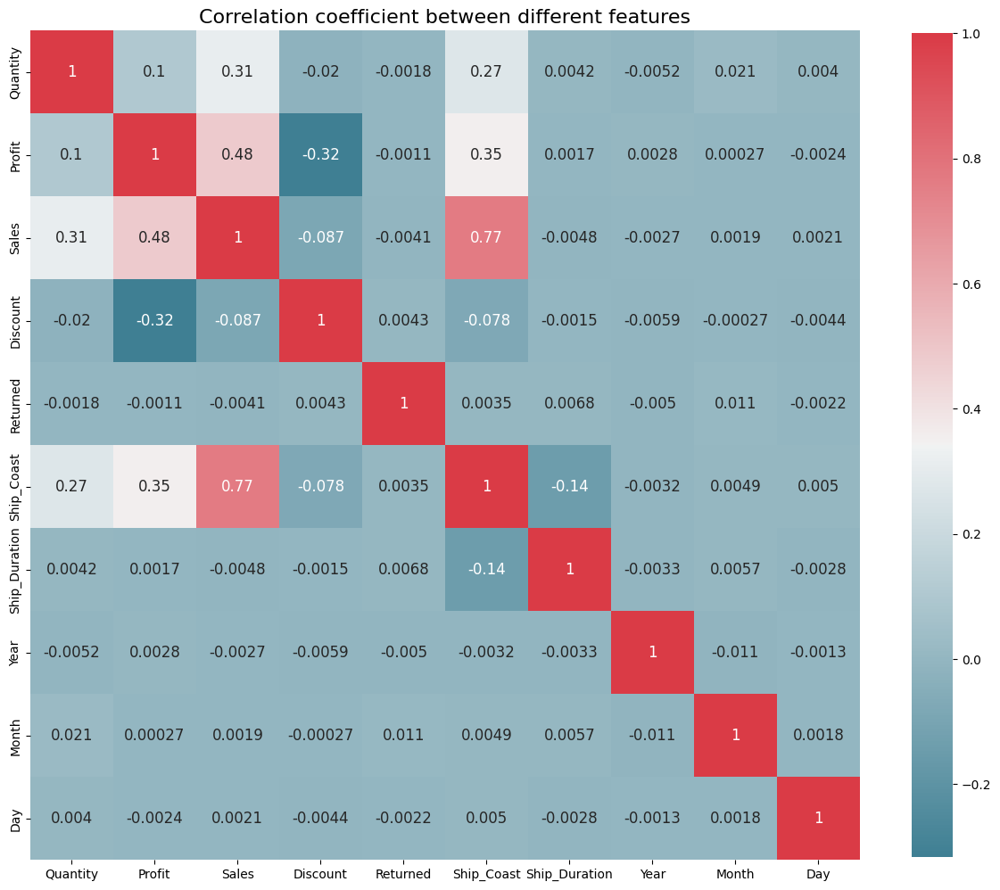

In [26]:
plot_correlation_map(data)

- **Positive Relationship**: When the correlation coefficient is close to (1)
- **Negative Relationship**: When the correlation coefficient is close to (-1)
- **Independent**: When X and Y are independent, then the correlation coefficient is close to zero (0)

- - -

<div style='font-size:100%;'>
    <a id='visualization'></a>
    <h3 style='color: black; font-weight: bold; font-family: Calibri;'>
        <center> Visualization of the different correlations 📉📈 </center>
    </h3>
</div>

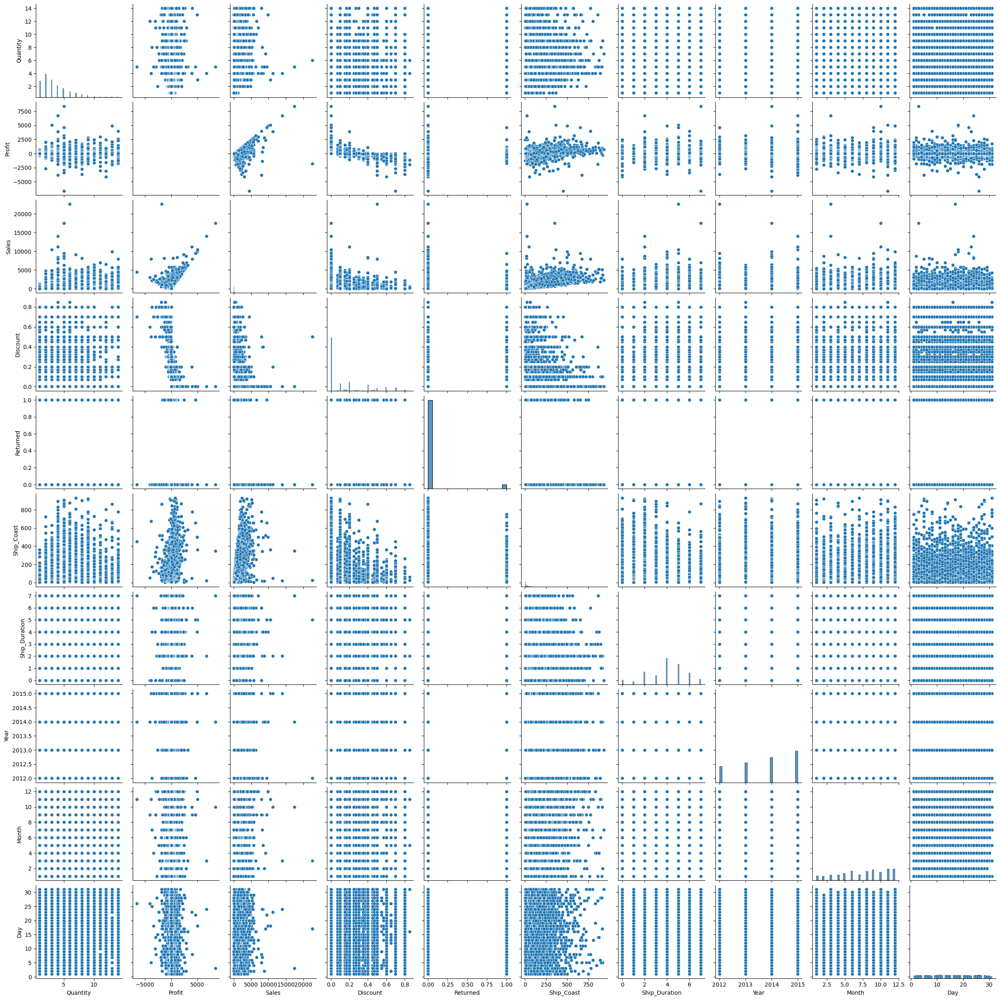

In [27]:
# features ditribution 
sns.pairplot(data)

<div style='font-size:100%;'>
    <a id='fs'></a>
    <h3 style='color: black; font-weight: bold; font-family: Calibri;'>
        <center> Feature Selection ✅ </center>
    </h3>
</div>

In [28]:
# Selecting the features that are correlated with our target
Features_For_Regression = ['Sales','Ship_Coast']

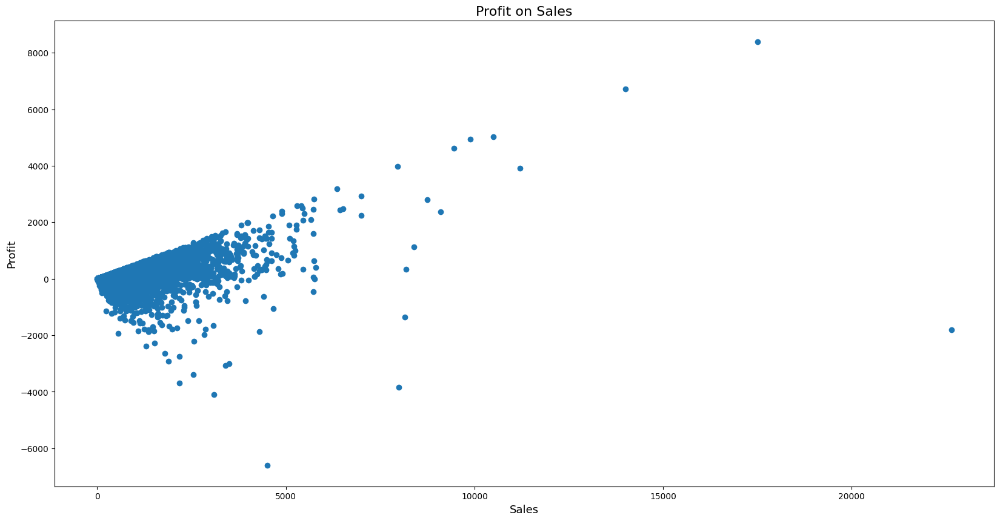

In [29]:
#ploting the profit on sales 
plt.rcParams.update({'figure.figsize':(20,10), 'figure.dpi':100})
x = data['Sales']
y =  data['Profit']
plt.title("Profit on Sales",fontsize = 16)
plt.xlabel("Sales",fontsize = 13)
plt.ylabel("Profit",fontsize = 13)
plt.scatter(x, y)
plt.show()

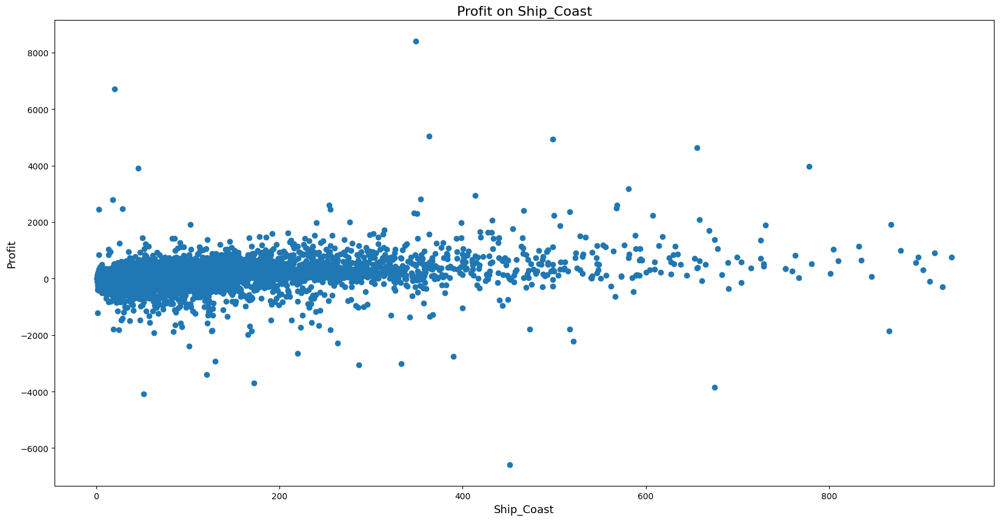

In [30]:
#ploting the profit on ship_coast
plt.rcParams.update({'figure.figsize':(20,10), 'figure.dpi':100})
x = data['Ship_Coast']
y =  data['Profit']
plt.title("Profit on Ship_Coast",fontsize = 16)
plt.xlabel("Ship_Coast",fontsize = 13)
plt.ylabel("Profit",fontsize = 13)
plt.scatter(x, y)
plt.show()

<div style='font-size:100%;'>
    <a id='outliers'></a>
    <h3 style='color: black; font-weight: bold; font-family: Calibri;'>
        <center> Dealing with outliers ❌</center>
    </h3>
</div>

In [31]:
fig = px.histogram(data_frame =data, 
                   x=["Sales","Ship_Coast"],
                   width=1000,
                   marginal="box",
                   nbins= 100,
                   template="plotly_white"
                )

fig.update_layout(title = "Distribution of Sales and Ship Coast" , title_x = 0.5)
fig.show()

In [32]:
fig = px.histogram(data_frame =data, 
                   x="Sales",
                   width=1000,
                   marginal="box",
                   nbins= 100,
                   template="plotly_white"
                )

fig.update_layout(title = "Distribution of Sales" , title_x = 0.5)
fig.show()

In [33]:
fig = px.histogram(data_frame =data, 
                   x="Ship_Coast",
                   width=1000,
                   marginal="box",
                   nbins= 100,
                   template="plotly_white"
                )

fig.update_layout(title = "Distribution of Ship_Coast" , title_x = 0.5)
fig.show()

In [34]:
fig = px.histogram(data_frame =data, 
                   x="Profit",
                   width=1000,
                   marginal="box",
                   nbins= 100,
                   template="plotly_white"
                )

fig.update_layout(title = "Distribution of Profit" , title_x = 0.5)
fig.show()

In [35]:
#defining the function remove_outlier 
def remove_outlier(df,column):
    Q1 = np.percentile(df[column], 25, interpolation = 'midpoint')
    #Q2 = np.percentile(df[column], 50, interpolation = 'midpoint')  
    Q3 = np.percentile(df[column], 75, interpolation = 'midpoint')
    IQR = Q3 - Q1
    low_lim = Q1 - 1.5 * IQR
    up_lim = Q3 + 1.5 * IQR
    print('*',column)
    print('low_limit is', low_lim)
    print('up_limit is', up_lim)
    print('\n')
    df=df[(df[column]< up_lim) & (df[column]>low_lim)]
    return df

In [36]:
# removing the outliers from the 3 features that we are going to use
data=remove_outlier(data,'Profit')
data=remove_outlier(data,'Sales')
data=remove_outlier(data,'Ship_Coast')

* Profit
low_limit is -55.184998512268066
up_limit is 91.97499752044678


* Sales
low_limit is -151.8600091934204
up_limit is 319.50001430511475


* Ship_Coast
low_limit is -11.339999437332153
up_limit is 24.179999113082886




In [37]:
fig = px.histogram(data_frame =data, 
                   x=["Sales","Ship_Coast"],
                   width=1000,
                   marginal="box",
                   nbins= 100,
                   template="plotly_white"
                )

fig.update_layout(title = "Distribution of Sales and Ship Coast" , title_x = 0.5)
fig.show()

In [38]:
fig = px.histogram(data_frame =data, 
                   x="Profit",
                   width=1000,
                   marginal="box",
                   nbins= 100,
                   template="plotly_white"
                )

fig.update_layout(title = "Distribution of Profit" , title_x = 0.5)
fig.show()


<div style='font-size:150%;'>
    <a id='lr'></a>
    <h1 style='color:#142b5a; font-weight: bold; font-family: Calibri;'>
        <center>Linear Regression</center>
    </h1>
</div>

<div style='font-size:100%;'>
    <a id='simple'></a>
    <h3 style='color: black; font-weight: bold; font-family: Calibri;'>
            a- Simple Linear regression 
    </h3>
</div>

## $$f(X)=aX+b $$

In [39]:
data['Sales'].shape

(35100,)

In [40]:
#changes a row vector to a column vector
data['Sales'].values[:,np.newaxis].shape

(35100, 1)

In [41]:
data['Profit'].values.shape

(35100,)

In [42]:
x=data['Sales'].values[:,np.newaxis]
y=data['Profit'].values

### ✂️ Splitting our dataset into train and test 

In [43]:
#splitting the dataset
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.3,random_state=40) 

In [44]:
#training the model
from sklearn.linear_model import LinearRegression
model=LinearRegression()   
# model is an instance of the LinearRegression class

In [45]:
model.fit(x_train,y_train)

LinearRegression()

In [46]:
print('For this model b =', model.intercept_)

For this model b = -2.008584971205094


In [47]:
print('For this model a =',float(model.coef_[0]))
model.coef_

For this model a = 0.174010535186025


array([0.17401054])

### ✅  Evaluating our regression model 
$$ R2 =1- \frac{\sum  (y_{vrai} - y_{pred} )^2}{\sum  (y_{vrai} - \overline{ y_{vrai}} )^2}  $$
$$ MAE = \frac{1}{m} \sum \lvert y_{vrai} - y_{pred} \rvert $$
$$ MSE = \frac{1}{m} \sum  (y_{vrai} - y_{pred} )^2 $$
$$ RMSE = \sqrt {\frac{1}{m} \sum  (y_{vrai} - y_{pred} )^2 }$$
$$MedianAE =median{\lvert y_{vrai} - y_{pred} \rvert} $$

In [48]:
from sklearn.metrics import mean_absolute_error,median_absolute_error,mean_squared_error,r2_score

print('\n****************** Evaluation on test set ******************\n')

y_pred=model.predict(x_test) 

print('R2 = ',r2_score(y_test, y_pred))
print('MSE = ',mean_squared_error(y_test, y_pred))
print('RMSE = ', np.sqrt(mean_squared_error(y_test, y_pred)))
print('MAE = ', mean_absolute_error(y_test, y_pred))
print('Meadian = ', median_absolute_error(y_test, y_pred))


****************** Evaluation on test set ******************

R2 =  0.24566456322492602
MSE =  366.596463112542
RMSE =  19.14670893685236
MAE =  13.046663315022945
Meadian =  7.9142670816355185


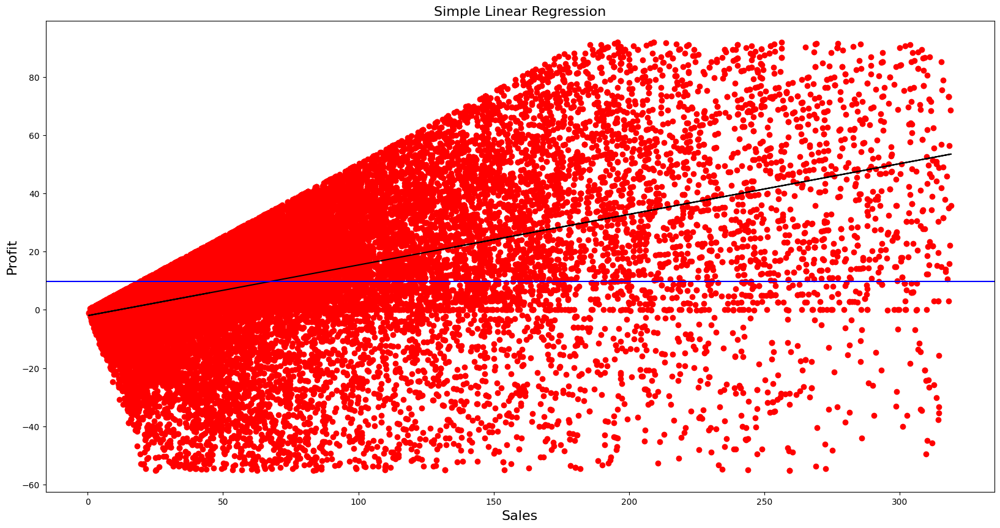

In [49]:
x=data['Sales'].values[:,np.newaxis]
y=data['Profit'].values
plt.scatter(x,y,color="r")
plt.title("Simple Linear Regression", fontsize = 16)
plt.ylabel("Profit", fontsize = 16)
plt.xlabel("Sales", fontsize = 16)
plt.plot(x,model.predict(x),color="k")
plt.axhline(y=data['Profit'].mean(),color="b")
plt.show()

In [50]:
x1=data['Ship_Coast'].values[:,np.newaxis]
y1=data['Profit'].values

In [51]:
from sklearn.model_selection import train_test_split
x_train1,x_test1,y_train1,y_test1=train_test_split(x1,y1,test_size=0.4,random_state=40) 

In [52]:
# training the model
from sklearn.linear_model import LinearRegression
model=LinearRegression()   
# model is an instance of the LinearRegression class
model.fit(x_train1,y_train1)

LinearRegression()

####  Let's evaluate our model (linear_model)

In [53]:
from sklearn.metrics import mean_absolute_error,median_absolute_error,mean_squared_error,r2_score

print('\n****************** Evaluation on test set ******************\n')

y_pred1=model.predict(x_test1) 

print('R2 = ',r2_score(y_test1, y_pred1))
print('MSE = ',mean_squared_error(y_test1, y_pred1))
print('RMSE = ', np.sqrt(mean_squared_error(y_test1, y_pred1)))
print('MAE = ', mean_absolute_error(y_test1, y_pred1))
print('Meadian = ', median_absolute_error(y_test1, y_pred1))


****************** Evaluation on test set ******************

R2 =  0.1555098362437548
MSE =  406.6482614529774
RMSE =  20.165521601311912
MAE =  13.636855296810277
Meadian =  8.218857889722347


#### Plotting the fitted model

In [54]:
print('For this model b =', model.intercept_)
print('For this model a =',float(model.coef_[0]))
model.coef_

For this model b = 0.1117052250286541
For this model a = 1.558074136018208


array([1.55807414])

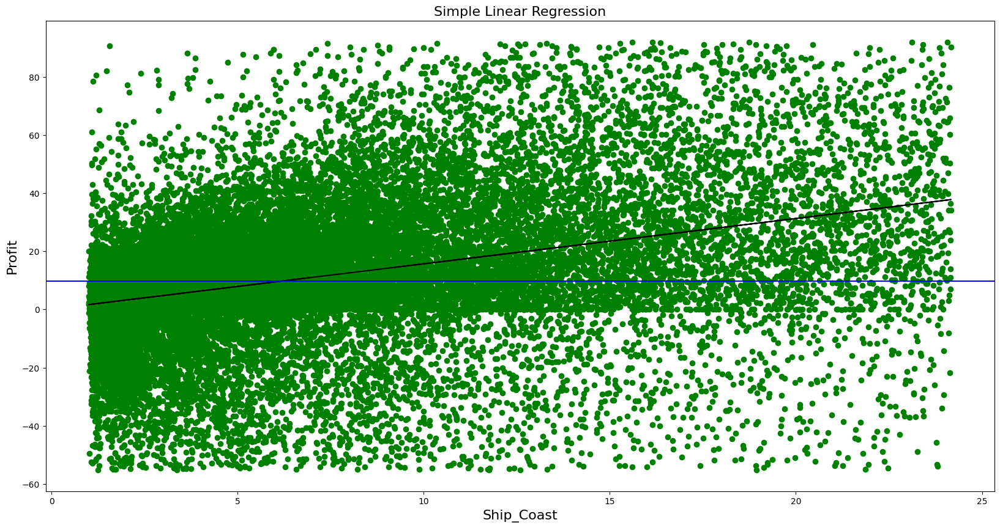

In [55]:
x1=data['Ship_Coast'].values[:,np.newaxis]
y1=data['Profit'].values
plt.scatter(x1,y1,color="g")
plt.title("Simple Linear Regression", fontsize = 16)
plt.ylabel("Profit", fontsize = 16)
plt.xlabel("Ship_Coast", fontsize = 16)
plt.plot(x1,model.predict(x1),color="k")
plt.axhline(y=data['Profit'].mean(),color="b")
plt.show()

<div style='font-size:100%;'>
    <a id='multiple'></a>
    <h3 style='color: black; font-weight: bold; font-family: Calibri;'>
            b- Multiple Linear regression 
    </h3>
</div>

## $$f(X_1,X_2,...,X_9)= a_1*X_1 + a_2*X_2 + .... + a_9*X9+b$$

In [56]:
print(Features_For_Regression)

['Sales', 'Ship_Coast']


In [57]:
x=data[Features_For_Regression]
y=data['Profit']

In [58]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.4,random_state=40)

In [59]:
model=LinearRegression()   
model.fit(x_train,y_train)

LinearRegression()

In [60]:
print('****************** Evaluation on test set ******************')
y_pred=model.predict(x_test) 

print('R2 = ',r2_score(y_test, y_pred))

print('MSE = ',mean_squared_error(y_test, y_pred))
print('RMSE = ', np.sqrt(mean_squared_error(y_test, y_pred)))
print('MAE = ', mean_absolute_error(y_test, y_pred))
print('Meadian = ', median_absolute_error(y_test, y_pred))

****************** Evaluation on test set ******************
R2 =  0.24654323098373576
MSE =  362.8128524761347
RMSE =  19.047646901287695
MAE =  13.00762952098374
Meadian =  7.898344516091019


<div style='font-size:150%;'>
    <a id='pr'></a>
    <h1 style='color:#142b5a; font-weight: bold; font-family: Calibri;'>
        <center>Polynomial Regression</center>
    </h1>
</div>

In [61]:
x=data[Features_For_Regression]
y=data['Profit']

In [62]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.3,random_state=0) 

In [63]:
lg=LinearRegression()

In [64]:
from sklearn.preprocessing import PolynomialFeatures
poly=PolynomialFeatures(degree=4)

In [65]:
x_train_fit =poly.fit_transform(x_train) 
lg.fit(x_train_fit, y_train)
x_test_ = poly.fit_transform(x_test)

In [66]:
print('****************** Evaluation on test set ******************')

y_pred = lg.predict(x_test_)

print('R2 = ',r2_score(y_test, y_pred))

print('MSE = ',mean_squared_error(y_test, y_pred))
print('RMSE = ', np.sqrt(mean_squared_error(y_test, y_pred)))
print('MAE = ', mean_absolute_error(y_test, y_pred))
print('Meadian = ', median_absolute_error(y_test, y_pred))

****************** Evaluation on test set ******************
R2 =  0.26715858624377464
MSE =  345.9061636458783
RMSE =  18.59855272987332
MAE =  12.866630966526499
Meadian =  8.395571135315787


In [67]:
x_test['profit_pred']=y_pred

In [68]:
x_test['profit']=y_test

In [69]:
x_test

,Sales,Ship_Coast,profit_pred,profit
3796,17.94,1.37,-0.02,4.49
5039,32.80,2.84,2.29,-22.16
50113,11.04,1.88,-0.55,1.86
15142,100.20,10.72,17.26,6.00
39929,88.83,6.89,14.96,36.36
...,...,...,...,...
7011,24.48,2.38,0.95,8.76
7445,17.58,2.56,0.16,-6.60
14141,22.64,2.16,0.68,-34.00
15779,10.09,1.69,-0.67,-3.55


<div style='font-size:150%;'>
    <a id='lstm'></a>
    <h1 style='color:#142b5a; font-weight: bold; font-family: Calibri;'>
        <center>LSTM Method</center>
    </h1>
</div>


In [70]:
dataFact

,FK_Customer,FK_Product,FK_Ship,FK_Date_Order,FK_Date_Ship,FK_Order,FK_Localisation,Quantity,Profit,Sales,Discount,Returned,Ship_Coast,Ship_Duration
0,17416,5806,5,2012-07-03,20120706,35224,5965,7,-4.21,44.93,0.45,NO,6.91,3
1,17416,5841,8,2015-01-07,20150111,36271,4078,5,-10.44,23.76,0.45,NO,2.84,4
2,17416,6612,5,2012-07-03,20120706,35224,5965,2,-23.53,51.71,0.45,NO,1.77,3
3,17416,6644,5,2012-07-03,20120706,35224,5965,13,-141.96,278.85,0.45,NO,30.01,3
4,17416,6939,5,2012-07-03,20120706,35224,5965,1,-8.53,29.24,0.45,NO,6.66,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51246,34828,5714,7,2012-09-19,20120921,37536,4348,4,11.94,59.94,0.10,NO,2.31,2
51247,34829,4431,8,2013-11-26,20131203,44326,7247,2,7.30,87.98,0.40,NO,9.11,7
51248,34829,7080,7,2015-06-18,20150621,46680,5897,3,69.74,590.12,0.00,NO,106.68,3
51249,34830,6058,8,2013-12-12,20131216,41454,5211,8,25.20,133.68,0.00,NO,4.76,4


In [71]:
dataFact['FK_Date_Order'] = pd.to_datetime(dataFact.FK_Date_Order, format='%Y-%m-%d')

In [72]:
data = dataFact.copy()

In [73]:
#represent month in date field as its first day
data['FK_Date_Order'] = data['FK_Date_Order'].dt.year.astype('str') + '-' + data['FK_Date_Order'].dt.month.astype('str') + '-01'
data['FK_Date_Order'] = pd.to_datetime(data['FK_Date_Order'])

removing the outliers from the feature "Profit"

In [75]:
def remove_outlier(df,column):
    Q1 = np.percentile(df[column], 25, interpolation = 'midpoint')
    #Q2 = np.percentile(df[column], 50, interpolation = 'midpoint')  
    Q3 = np.percentile(df[column], 75, interpolation = 'midpoint')
    IQR = Q3 - Q1
    low_lim = Q1 - 1.5 * IQR
    up_lim = Q3 + 1.5 * IQR
    print('*',column)
    print('low_limit is', low_lim)
    print('up_limit is', up_lim)
    print('\n')
    df=df[(df[column]< up_lim) & (df[column]>low_lim)]
    return df

In [76]:
data=remove_outlier(data,'Profit')

* Profit
low_limit is -55.184998512268066
up_limit is 91.97499752044678




In [78]:
data = data.groupby('FK_Date_Order').Profit.sum().reset_index()

In [79]:
#plot monthly sales
plot_data = [
    go.Scatter(
        x=data['FK_Date_Order'],
        y=data['Profit'],
    )
]
plot_layout = go.Layout(
        title='Monthly Profit'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

In [80]:
#create a new dataframe to model the difference
df_diff = data.copy()
#add previous sales to the next row
df_diff['prev_Profit'] = df_diff['Profit'].shift(1)
#drop the null values and calculate the difference
df_diff = df_diff.dropna()
df_diff['diff'] = (df_diff['Profit'] - df_diff['prev_Profit'])
df_diff

,FK_Date_Order,Profit,prev_Profit,diff
1,2012-02-01,5412.95,3923.99,1488.96
2,2012-03-01,5913.91,5412.95,500.96
3,2012-04-01,6070.29,5913.91,156.38
4,2012-05-01,6930.69,6070.29,860.41
5,2012-06-01,8357.36,6930.69,1426.67
6,2012-07-01,4818.54,8357.36,-3538.82
7,2012-08-01,10022.26,4818.54,5203.72
8,2012-09-01,12112.10,10022.26,2089.84
9,2012-10-01,8870.77,12112.10,-3241.33
10,2012-11-01,12026.82,8870.77,3156.05


In [81]:
#plot sales diff
plot_data = [
    go.Scatter(
        x=df_diff['FK_Date_Order'],
        y=df_diff['diff'],
    )
]
plot_layout = go.Layout(
        title='Monthly Profit Difference'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

In [82]:
#create dataframe for transformation from time series to supervised
df_supervised = df_diff.drop(['prev_Profit'],axis=1)

#adding lags
for inc in range(1,24):
    field_name = 'lag_' + str(inc)
    df_supervised[field_name] = df_supervised['diff'].shift(inc)
#drop null values
df_supervised = df_supervised.dropna().reset_index(drop=True)

In [83]:
df_supervised.head()

,FK_Date_Order,Profit,diff,lag_1,lag_2,lag_3,lag_4,lag_5,lag_6,lag_7,lag_8,lag_9,lag_10,lag_11,lag_12,lag_13,lag_14,lag_15,lag_16,lag_17,lag_18,lag_19,lag_20,lag_21,lag_22,lag_23
0,2014-01-01,7961.80,-5858.89,-1327.63,3895.42,-2738.67,1667.59,5546.75,-5455.37,3081.18,2533.05,75.59,2538.68,-1595.25,-7244.69,817.21,3156.05,-3241.33,2089.84,5203.72,-3538.82,1426.67,860.41,156.38,500.96,1488.96
1,2014-02-01,7008.93,-952.87,-5858.89,-1327.63,3895.42,-2738.67,1667.59,5546.75,-5455.37,3081.18,2533.05,75.59,2538.68,-1595.25,-7244.69,817.21,3156.05,-3241.33,2089.84,5203.72,-3538.82,1426.67,860.41,156.38,500.96
2,2014-03-01,8659.26,1650.33,-952.87,-5858.89,-1327.63,3895.42,-2738.67,1667.59,5546.75,-5455.37,3081.18,2533.05,75.59,2538.68,-1595.25,-7244.69,817.21,3156.05,-3241.33,2089.84,5203.72,-3538.82,1426.67,860.41,156.38
3,2014-04-01,7023.30,-1635.96,1650.33,-952.87,-5858.89,-1327.63,3895.42,-2738.67,1667.59,5546.75,-5455.37,3081.18,2533.05,75.59,2538.68,-1595.25,-7244.69,817.21,3156.05,-3241.33,2089.84,5203.72,-3538.82,1426.67,860.41
4,2014-05-01,12499.13,5475.83,-1635.96,1650.33,-952.87,-5858.89,-1327.63,3895.42,-2738.67,1667.59,5546.75,-5455.37,3081.18,2533.05,75.59,2538.68,-1595.25,-7244.69,817.21,3156.05,-3241.33,2089.84,5203.72,-3538.82,1426.67


In [84]:
# Import statsmodels.formula.api
import statsmodels.formula.api as smf
# Define the regression formula
model = smf.ols(formula='diff ~ lag_1 + lag_2 + lag_3 +lag_4 + lag_5 + lag_6 + lag_7 + lag_8 + lag_9 + lag_10 + lag_11 + lag_12 + lag_13  + lag_14 + lag_15 + lag_16 + lag_17 + lag_18 + lag_19    ', data=df_supervised)
# Fit the regression
model_fit = model.fit()
# Extract the adjusted r-squared
regression_adj_rsq = model_fit.rsquared_adj
print(regression_adj_rsq)

0.8041546209824709


In [85]:
#Centrage réduction

In [86]:
#import MinMaxScaler and create a new dataframe for LSTM model
from sklearn.preprocessing import MinMaxScaler
df_model = df_supervised.drop(['FK_Date_Order','Profit'],axis=1)
#split train and test set
train_set, test_set = df_model[0:-6].values, df_model[-6:].values

In [87]:
#apply Min Max Scaler
scaler = MinMaxScaler(feature_range=(-1, 1))
scaler = scaler.fit(train_set)
# reshape training set
train_set = train_set.reshape(train_set.shape[0], train_set.shape[1])
train_set_scaled = scaler.transform(train_set)
# reshape test set
test_set = test_set.reshape(test_set.shape[0], test_set.shape[1])
test_set_scaled = scaler.transform(test_set)

In [88]:
#LSTM

In [89]:
X_train, y_train = train_set_scaled[:, 1:], train_set_scaled[:, 0:1]
X_train = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test, y_test = test_set_scaled[:, 1:], test_set_scaled[:, 0:1]
X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

In [90]:
model = Sequential()
model.add(LSTM(100, batch_input_shape=(1, X_train.shape[1], X_train.shape[2]), stateful=True))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')
# batch size =  the number of samples to work through before updating the internal model parameters
# epoch = the number times that the learning algorithm will work through the entire training dataset
model.fit(X_train, y_train, epochs=800, batch_size=1, verbose=1, shuffle=False)

Epoch 1/800
18/18 [==============================] - 1s 1ms/step - loss: 0.3635
Epoch 2/800
18/18 [==============================] - 0s 1ms/step - loss: 0.2154
Epoch 3/800
18/18 [==============================] - 0s 1ms/step - loss: 0.1435
Epoch 4/800
18/18 [==============================] - 0s 1ms/step - loss: 0.1043
Epoch 5/800
18/18 [==============================] - 0s 1ms/step - loss: 0.0820
Epoch 6/800
18/18 [==============================] - 0s 1ms/step - loss: 0.0660
Epoch 7/800
18/18 [==============================] - 0s 1ms/step - loss: 0.0539
Epoch 8/800
18/18 [==============================] - 0s 1ms/step - loss: 0.0442
Epoch 9/800
18/18 [==============================] - 0s 1ms/step - loss: 0.0359
Epoch 10/800
18/18 [==============================] - 0s 1ms/step - loss: 0.0288
Epoch 11/800
18/18 [==============================] - 0s 1ms/step - loss: 0.0230
Epoch 12/800
18/18 [==============================] - 0s 1ms/step - loss: 0.0183
Epoch 13/800
18/18 [=================

In [91]:
y_pred = model.predict(X_test,batch_size=1)

6/6 [==============================] - 0s 1ms/step


In [92]:
#reshape y_pred
y_pred = y_pred.reshape(y_pred.shape[0], 1, y_pred.shape[1])
#rebuild test set for inverse transform
pred_test_set = []
for index in range(0,len(y_pred)):
      np.concatenate([y_pred[index],X_test[index]],axis=1)
      pred_test_set.append(np.concatenate([y_pred[index],X_test[index]],axis=1))
    
#reshape pred_test_set
pred_test_set = np.array(pred_test_set)
pred_test_set = pred_test_set.reshape(pred_test_set.shape[0], pred_test_set.shape[2])
#inverse transform
pred_test_set_inverted = scaler.inverse_transform(pred_test_set)

In [93]:
#create dataframe that shows the predicted Profit
result_list = []
Profit_dates = list(data[-7:].FK_Date_Order)
act_Profit = list(data[-7:].Profit)
for index in range(0,len(pred_test_set_inverted)):
    result_dict = {}
    result_dict['predicted_LSTM_Profit'] = int(pred_test_set_inverted[index][0] + act_Profit[index])
    result_dict['FK_Date_Order'] = Profit_dates[index+1]
    result_list.append(result_dict)
df_result_LSTM = pd.DataFrame(result_list)

In [94]:
#merge with actual Profit dataframe
df_sales_pred = pd.merge(data,df_result_LSTM,on='FK_Date_Order',how='left')
#plot actual and predicted
plot_data = [
    go.Scatter(
        x=df_sales_pred['FK_Date_Order'],
        y=df_sales_pred['Profit'],
        name='actual'
    ),
        go.Scatter(
        x=df_sales_pred['FK_Date_Order'],
        y=df_sales_pred['predicted_LSTM_Profit'],
        name='predicted'
    )
    
]
plot_layout = go.Layout(
        title='Profit Prediction'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

In [95]:
# source : https://towardsdatascience.com/predicting-sales-611cb5a252de

<div style='font-size:150%;'>
    <a id='xgboost'></a>
    <h1 style='color:#142b5a; font-weight: bold; font-family: Calibri;'>
        <center>XGBOOST Method</center>
    </h1>
</div>

In [96]:
from xgboost.sklearn import XGBRegressor

In [97]:
df_supervised.head()

,FK_Date_Order,Profit,diff,lag_1,lag_2,lag_3,lag_4,lag_5,lag_6,lag_7,lag_8,lag_9,lag_10,lag_11,lag_12,lag_13,lag_14,lag_15,lag_16,lag_17,lag_18,lag_19,lag_20,lag_21,lag_22,lag_23
0,2014-01-01,7961.80,-5858.89,-1327.63,3895.42,-2738.67,1667.59,5546.75,-5455.37,3081.18,2533.05,75.59,2538.68,-1595.25,-7244.69,817.21,3156.05,-3241.33,2089.84,5203.72,-3538.82,1426.67,860.41,156.38,500.96,1488.96
1,2014-02-01,7008.93,-952.87,-5858.89,-1327.63,3895.42,-2738.67,1667.59,5546.75,-5455.37,3081.18,2533.05,75.59,2538.68,-1595.25,-7244.69,817.21,3156.05,-3241.33,2089.84,5203.72,-3538.82,1426.67,860.41,156.38,500.96
2,2014-03-01,8659.26,1650.33,-952.87,-5858.89,-1327.63,3895.42,-2738.67,1667.59,5546.75,-5455.37,3081.18,2533.05,75.59,2538.68,-1595.25,-7244.69,817.21,3156.05,-3241.33,2089.84,5203.72,-3538.82,1426.67,860.41,156.38
3,2014-04-01,7023.30,-1635.96,1650.33,-952.87,-5858.89,-1327.63,3895.42,-2738.67,1667.59,5546.75,-5455.37,3081.18,2533.05,75.59,2538.68,-1595.25,-7244.69,817.21,3156.05,-3241.33,2089.84,5203.72,-3538.82,1426.67,860.41
4,2014-05-01,12499.13,5475.83,-1635.96,1650.33,-952.87,-5858.89,-1327.63,3895.42,-2738.67,1667.59,5546.75,-5455.37,3081.18,2533.05,75.59,2538.68,-1595.25,-7244.69,817.21,3156.05,-3241.33,2089.84,5203.72,-3538.82,1426.67


In [98]:
#import MinMaxScaler and create a new dataframe for LSTM model
from sklearn.preprocessing import MinMaxScaler
df_model = df_supervised.drop(['FK_Date_Order','Profit'],axis=1)
#split train and test set
train_set, test_set = df_model[0:-6].values, df_model[-6:].values

In [99]:
#apply Min Max Scaler
scaler = MinMaxScaler(feature_range=(-1, 1))
scaler = scaler.fit(train_set)
# reshape training set
train_set = train_set.reshape(train_set.shape[0], train_set.shape[1])
train_set_scaled = scaler.transform(train_set)
# reshape test set
test_set = test_set.reshape(test_set.shape[0], test_set.shape[1])
test_set_scaled = scaler.transform(test_set)

In [100]:
X_train, y_train = train_set_scaled[:, 1:], train_set_scaled[:, 0:1].ravel()
X_test, y_test = test_set_scaled[:, 1:], test_set_scaled[:, 0:1].ravel()

In [101]:
# Run regression model
XG = XGBRegressor(n_estimators=200,learning_rate=0.5,objective='reg:squarederror')

XG.fit(X_train, y_train)
y_pred = XG.predict(X_test)


In [102]:
#reshape y_pred
y_pred = y_pred.reshape(y_pred.shape[0], 1,1)
X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
#rebuild test set for inverse transform
pred_test_set = []
for index in range(0,len(y_pred)):
     pred_test_set.append(np.concatenate([y_pred[index],X_test[index]],axis=1))
    
#reshape pred_test_set
pred_test_set = np.array(pred_test_set)
pred_test_set = pred_test_set.reshape(pred_test_set.shape[0], pred_test_set.shape[2])
#inverse transform
pred_test_set_inverted = scaler.inverse_transform(pred_test_set)

In [103]:
#create dataframe that shows the predicted Profit
result_list = []
Profit_dates = list(data[-7:].FK_Date_Order)
act_Profit = list(data[-7:].Profit)
for index in range(0,len(pred_test_set_inverted)):
    result_dict = {}
    result_dict['predicted_XGBOOST_Profit'] = int(pred_test_set_inverted[index][0] + act_Profit[index])
    result_dict['FK_Date_Order'] = Profit_dates[index+1]
    result_list.append(result_dict)
df_result_XGBOOST = pd.DataFrame(result_list)

In [104]:
#merge with actual Profit dataframe
df_sales_pred = pd.merge(data,df_result_XGBOOST,on='FK_Date_Order',how='left')
#plot actual and predicted
plot_data = [
    go.Scatter(
        x=df_sales_pred['FK_Date_Order'],
        y=df_sales_pred['Profit'],
        name='actual'
    ),
        go.Scatter(
        x=df_sales_pred['FK_Date_Order'],
        y=df_sales_pred['predicted_XGBOOST_Profit'],
        name='predicted'
    )
    
]
plot_layout = go.Layout(
        title='Profit Prediction'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

<div style='font-size:150%;'>
    <a id='randomForest'></a>
    <h1 style='color:#142b5a; font-weight: bold; font-family: Calibri;'>
        <center>RandomForest Method</center>
    </h1>
</div>

In [105]:
df_supervised.head()

,FK_Date_Order,Profit,diff,lag_1,lag_2,lag_3,lag_4,lag_5,lag_6,lag_7,lag_8,lag_9,lag_10,lag_11,lag_12,lag_13,lag_14,lag_15,lag_16,lag_17,lag_18,lag_19,lag_20,lag_21,lag_22,lag_23
0,2014-01-01,7961.80,-5858.89,-1327.63,3895.42,-2738.67,1667.59,5546.75,-5455.37,3081.18,2533.05,75.59,2538.68,-1595.25,-7244.69,817.21,3156.05,-3241.33,2089.84,5203.72,-3538.82,1426.67,860.41,156.38,500.96,1488.96
1,2014-02-01,7008.93,-952.87,-5858.89,-1327.63,3895.42,-2738.67,1667.59,5546.75,-5455.37,3081.18,2533.05,75.59,2538.68,-1595.25,-7244.69,817.21,3156.05,-3241.33,2089.84,5203.72,-3538.82,1426.67,860.41,156.38,500.96
2,2014-03-01,8659.26,1650.33,-952.87,-5858.89,-1327.63,3895.42,-2738.67,1667.59,5546.75,-5455.37,3081.18,2533.05,75.59,2538.68,-1595.25,-7244.69,817.21,3156.05,-3241.33,2089.84,5203.72,-3538.82,1426.67,860.41,156.38
3,2014-04-01,7023.30,-1635.96,1650.33,-952.87,-5858.89,-1327.63,3895.42,-2738.67,1667.59,5546.75,-5455.37,3081.18,2533.05,75.59,2538.68,-1595.25,-7244.69,817.21,3156.05,-3241.33,2089.84,5203.72,-3538.82,1426.67,860.41
4,2014-05-01,12499.13,5475.83,-1635.96,1650.33,-952.87,-5858.89,-1327.63,3895.42,-2738.67,1667.59,5546.75,-5455.37,3081.18,2533.05,75.59,2538.68,-1595.25,-7244.69,817.21,3156.05,-3241.33,2089.84,5203.72,-3538.82,1426.67


In [106]:
#import MinMaxScaler and create a new dataframe for LSTM model
from sklearn.preprocessing import MinMaxScaler
df_model = df_supervised.drop(['FK_Date_Order','Profit'],axis=1)
#split train and test set
train_set, test_set = df_model[0:-6].values, df_model[-6:].values

In [107]:
#apply Min Max Scaler
scaler = MinMaxScaler(feature_range=(-1, 1))
scaler = scaler.fit(train_set)
# reshape training set
train_set = train_set.reshape(train_set.shape[0], train_set.shape[1])
train_set_scaled = scaler.transform(train_set)
# reshape test set
test_set = test_set.reshape(test_set.shape[0], test_set.shape[1])
test_set_scaled = scaler.transform(test_set)

In [108]:
X_train, y_train = train_set_scaled[:, 1:], train_set_scaled[:, 0:1].ravel()
X_test, y_test = test_set_scaled[:, 1:], test_set_scaled[:, 0:1].ravel()

In [109]:
from sklearn.ensemble import RandomForestRegressor


In [110]:

# Run regression model
RF = RandomForestRegressor(n_estimators=200,max_depth=10)
#n_estimators = The number of trees in the forest.
#max_depth = The maximum depth of the tree.
RF.fit(X_train, y_train)
y_pred = RF.predict(X_test)


In [111]:
#reshape y_pred
y_pred = y_pred.reshape(y_pred.shape[0], 1,1)
X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
#rebuild test set for inverse transform
pred_test_set = []
for index in range(0,len(y_pred)):
     pred_test_set.append(np.concatenate([y_pred[index],X_test[index]],axis=1))
    
#reshape pred_test_set
pred_test_set = np.array(pred_test_set)
pred_test_set = pred_test_set.reshape(pred_test_set.shape[0], pred_test_set.shape[2])
#inverse transform
pred_test_set_inverted = scaler.inverse_transform(pred_test_set)

In [112]:
#create dataframe that shows the predicted Profit
result_list = []
Profit_dates = list(data[-7:].FK_Date_Order)
act_Profit = list(data[-7:].Profit)
for index in range(0,len(pred_test_set_inverted)):
    result_dict = {}
    result_dict['predicted_RANDOMFOREST_Profit'] = int(pred_test_set_inverted[index][0] + act_Profit[index])
    result_dict['FK_Date_Order'] = Profit_dates[index+1]
    result_list.append(result_dict)
df_result_RANDOMFOREST = pd.DataFrame(result_list)


In [113]:
#merge with actual Profit dataframe
df_sales_pred = pd.merge(data,df_result_RANDOMFOREST,on='FK_Date_Order',how='left')
#plot actual and predicted
plot_data = [
    go.Scatter(
        x=df_sales_pred['FK_Date_Order'],
        y=df_sales_pred['Profit'],
        name='actual'
    ),
        go.Scatter(
        x=df_sales_pred['FK_Date_Order'],
        y=df_sales_pred['predicted_RANDOMFOREST_Profit'],
        name='predicted'
    )
    
]
plot_layout = go.Layout(
        title='Profit Prediction'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

<div style='font-size:150%;'>
    <a id='comparison'></a>
    <h1 style='color:#142b5a; font-weight: bold; font-family: Calibri;'>
        <center>Comparison</center>
    </h1>
</div>

In [114]:
#merge with actual sales dataframe
df_sales_pred = pd.merge(data,df_result_LSTM,on='FK_Date_Order',how='left')
df_sales_pred1 = pd.merge(df_sales_pred,df_result_XGBOOST,on='FK_Date_Order',how='left')
df_sales_pred2 = pd.merge(df_sales_pred1,df_result_RANDOMFOREST,on='FK_Date_Order',how='left')
#plot actual and predicted
plot_data = [
    go.Scatter(
        x=df_sales_pred2['FK_Date_Order'],
        y=df_sales_pred2['Profit'],
        name='actual'
    ),
        go.Scatter(
        x=df_sales_pred2['FK_Date_Order'],
        y=df_sales_pred2['predicted_XGBOOST_Profit'],
        name='XGBOOST'
    )
    ,
        go.Scatter(
        x=df_sales_pred2['FK_Date_Order'],
        y=df_sales_pred2['predicted_LSTM_Profit'],
        name='LSTM'
    )
    ,
        go.Scatter(
        x=df_sales_pred2['FK_Date_Order'],
        y=df_sales_pred2['predicted_RANDOMFOREST_Profit'],
        name='RANDOMFOREST'
          
    )
    
]
plot_layout = go.Layout(
        title='Profit Prediction Comparaison'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

In [115]:
df_sales_pred2[42:]

,FK_Date_Order,Profit,predicted_LSTM_Profit,predicted_XGBOOST_Profit,predicted_RANDOMFOREST_Profit
42,2015-07-01,11381.23,13248.00,12971.00,13578.00
43,2015-08-01,19453.39,17819.00,16439.00,15474.00
44,2015-09-01,21501.69,19304.00,20255.00,19408.00
45,2015-10-01,16463.82,14268.00,15856.00,17493.00
46,2015-11-01,22658.70,20701.00,22212.00,19602.00
47,2015-12-01,21624.64,24992.00,22182.00,23734.00


<AxesSubplot: >

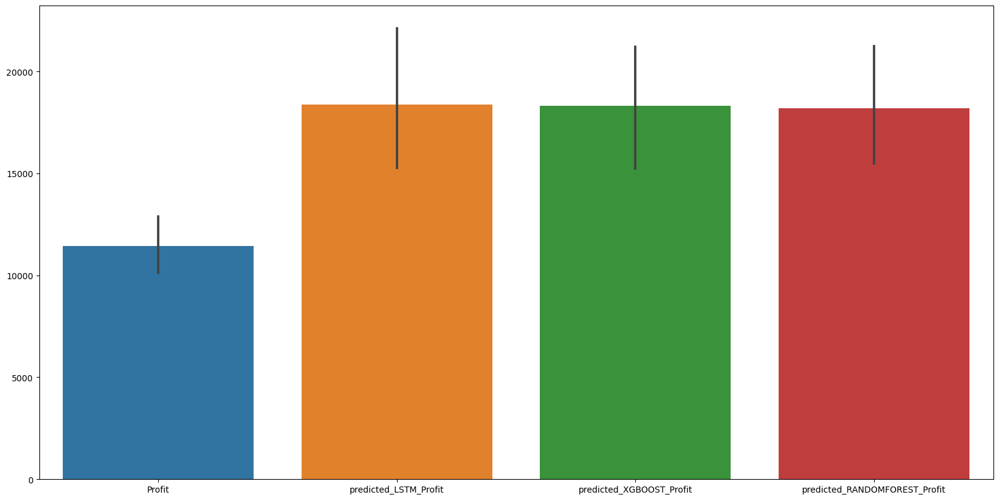

In [116]:
sns.barplot(data=df_sales_pred2)

In [117]:
accuracy=df_sales_pred2[42:].copy()

In [118]:
accuracy['LSTM_accuracy']=accuracy['predicted_LSTM_Profit']/accuracy['Profit'].round()
accuracy['XGBOOST__accuracy']=accuracy['predicted_XGBOOST_Profit']/accuracy['Profit'].round()
accuracy['RANDOMFOREST_accuracy']=accuracy['predicted_RANDOMFOREST_Profit']/accuracy['Profit'].round()

In [119]:
for i in range(42,48):
    if (accuracy.at[i,'LSTM_accuracy']>1):
        accuracy.at[i,'LSTM_accuracy']=1+(1- accuracy.at[i,'LSTM_accuracy'])
    if (accuracy.at[i,'XGBOOST__accuracy']>1):
        accuracy.at[i,'XGBOOST__accuracy']=1+(1- accuracy.at[i,'XGBOOST__accuracy'])
    if (accuracy.at[i,'RANDOMFOREST_accuracy']>1):
        accuracy.at[i,'RANDOMFOREST_accuracy']=1+(1- accuracy.at[i,'RANDOMFOREST_accuracy'])
    

In [120]:
accuracy

,FK_Date_Order,Profit,predicted_LSTM_Profit,predicted_XGBOOST_Profit,predicted_RANDOMFOREST_Profit,LSTM_accuracy,XGBOOST__accuracy,RANDOMFOREST_accuracy
42,2015-07-01,11381.23,13248.00,12971.00,13578.00,0.84,0.86,0.81
43,2015-08-01,19453.39,17819.00,16439.00,15474.00,0.92,0.85,0.80
44,2015-09-01,21501.69,19304.00,20255.00,19408.00,0.90,0.94,0.90
45,2015-10-01,16463.82,14268.00,15856.00,17493.00,0.87,0.96,0.94
46,2015-11-01,22658.70,20701.00,22212.00,19602.00,0.91,0.98,0.87
47,2015-12-01,21624.64,24992.00,22182.00,23734.00,0.84,0.97,0.90


In [121]:
accuracy.product()

Profit                          38403559115930144350404608.00
predicted_LSTM_Profit           33638482401931153859674112.00
predicted_XGBOOST_Profit        33741400529501062955008000.00
predicted_RANDOMFOREST_Profit   33185991637182361615990784.00
LSTM_accuracy                                            0.46
XGBOOST__accuracy                                        0.63
RANDOMFOREST_accuracy                                    0.42
dtype: float64